In [1]:
%reload_ext autotime
import pandas as pd
import requests
from pprint import pprint
import json
import torch
from PIL import Image
from transformers import MllamaForConditionalGeneration, AutoProcessor
from tqdm.auto import tqdm

pd.options.plotting.backend = "plotly"
pd.set_option("display.max_columns", None)
pd.set_option("display.max_colwidth", 100)

2024-12-12 09:24:02.300884: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-12-12 09:24:02.313220: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-12 09:24:02.329137: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-12 09:24:02.334326: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-12 09:24:02.348072: I tensorflow/core/platform/cpu_feature_guar

In [13]:
df = pd.read_csv("results.csv").drop_duplicates(subset="panoid")
df

,Index,pid,n,time,anxiousness,latitude,longitude,geometry,panoid,panolat,panolon,panodate
0,0,P20001,1,2023-04-25T02:51:42Z,0,-36.924795,174.738044,POINT (174.7380435 -36.92479483),IvrcS0W1RlFAlnci-p39XA,-36.924665,174.737914,2012-04
10,10,P20001,11,2023-04-24T00:42:25Z,0,-36.924837,174.737948,POINT (174.7379477 -36.92483659),QEpZV7bnO2mBfp0weMUKEg,-36.924730,174.737826,2012-04
13,13,P20006,1,2023-06-03T02:45:55Z,3,-36.892203,174.740125,POINT (174.7401253 -36.89220256),omb98QNjTPWi0uUfMsmYeg,-36.892621,174.739961,2024-05
14,15,P20009,2,2023-05-17T04:54:48Z,3,-36.923191,174.748620,POINT (174.7486203 -36.92319093),E7B5AV3DQ1rYWDClVRo8Zg,-36.923194,174.748831,2024-05
17,19,P20009,6,2023-05-19T22:28:51Z,1,-36.923260,174.748655,POINT (174.748655 -36.92325959),KCTcsxYCIm41XdzkYEYUQw,-36.923286,174.748840,2024-05
19,21,P20015,1,2023-05-17T07:34:00Z,5,-36.921603,174.747739,POINT (174.747739 -36.92160252),ESE0Slg2IO7Vf3QdBhETkg,-36.921626,174.747253,2024-05
22,24,P20021,1,2023-06-03T03:55:41Z,1,-38.140714,176.251862,POINT (176.2518616 -38.14071376),AF1QipNiSoDDA2omwMtXrIq76eZTz6u7JXaIMz2lY2HN,-38.140783,176.251412,2017-04-01
23,25,P20021,2,2023-06-04T02:33:49Z,6,-37.675727,175.209414,POINT (175.2094142 -37.67572725),_0GQKQIk42dFPo3qVzblaw,-37.675754,175.209423,2023-11
24,26,P20021,3,2023-06-05T21:49:46Z,3,-36.894889,174.742775,POINT (174.7427751 -36.89488899),qgtMQGHZWUUIBCa8JgbBhA,-36.895076,174.742734,2024-05
25,27,P20021,4,2023-06-06T02:29:11Z,5,-36.894854,174.742929,POINT (174.7429285 -36.89485419),T4yBf38jq472FmvtzEtI_w,-36.895101,174.742848,2024-05


In [3]:
# Loading this model needs about 22.69GB of GPU memory
model_id = "meta-llama/Llama-3.2-11B-Vision-Instruct"

model = MllamaForConditionalGeneration.from_pretrained(
    model_id,
    torch_dtype=torch.bfloat16,
    device_map="auto",
)
processor = AutoProcessor.from_pretrained(model_id)

The model weights are not tied. Please use the `tie_weights` method before using the `infer_auto_device` function.


Loading checkpoint shards:   0%|          | 0/5 [00:00<?, ?it/s]

0it [00:00, ?it/s]

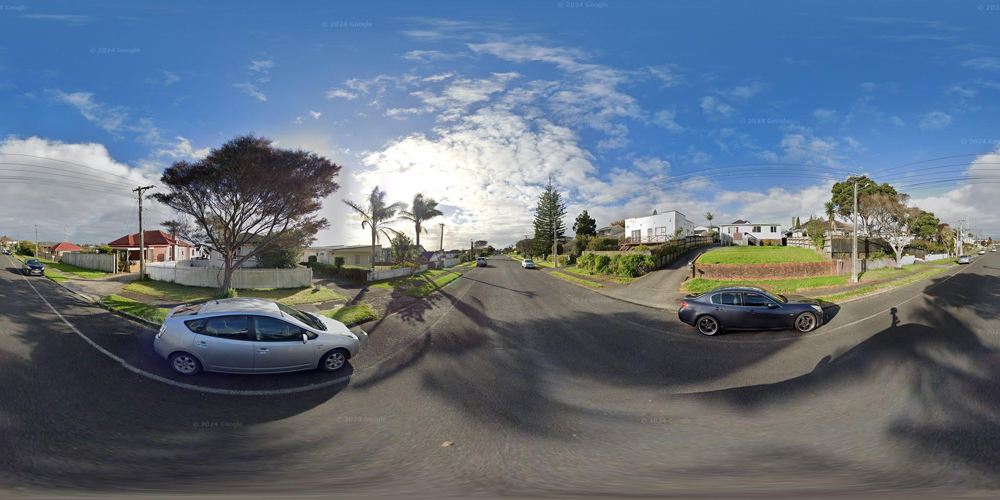

Output:
{'bikes': 0,
 'cars': 4,
 'environment': 'residential',
 'green': 60,
 'obscured': 40,
 'people': 1,
 'water': 0}




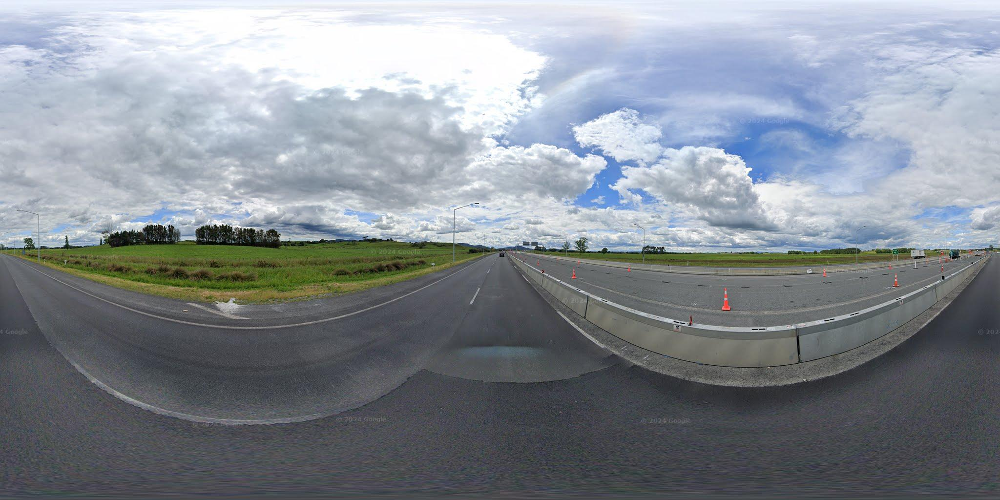

Output:
{'bikes': 0,
 'cars': 0,
 'environment': 'residential',
 'green': 45,
 'obscured': 0,
 'people': 0,
 'water': 0}




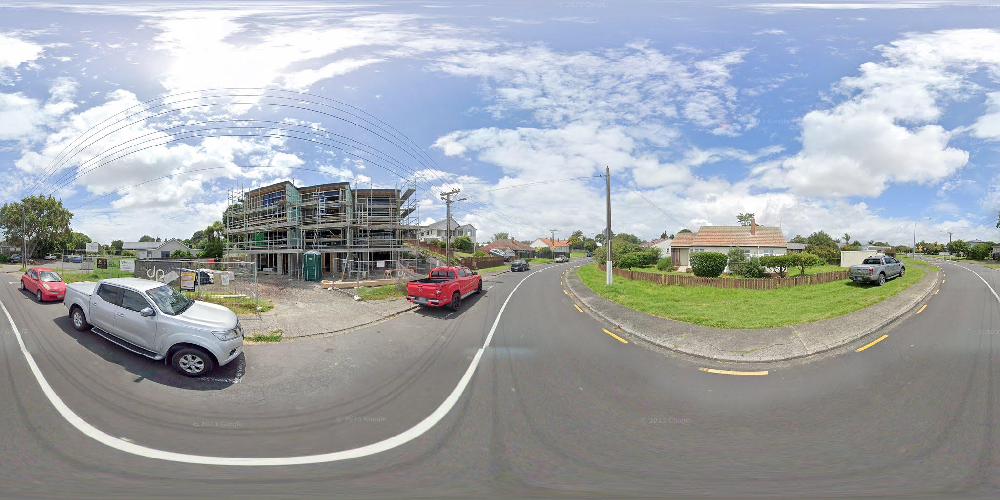

Output:
{'bikes': 0,
 'cars': 3,
 'environment': 'residential',
 'green': 0,
 'obscured': 0,
 'people': 0,
 'water': 0}




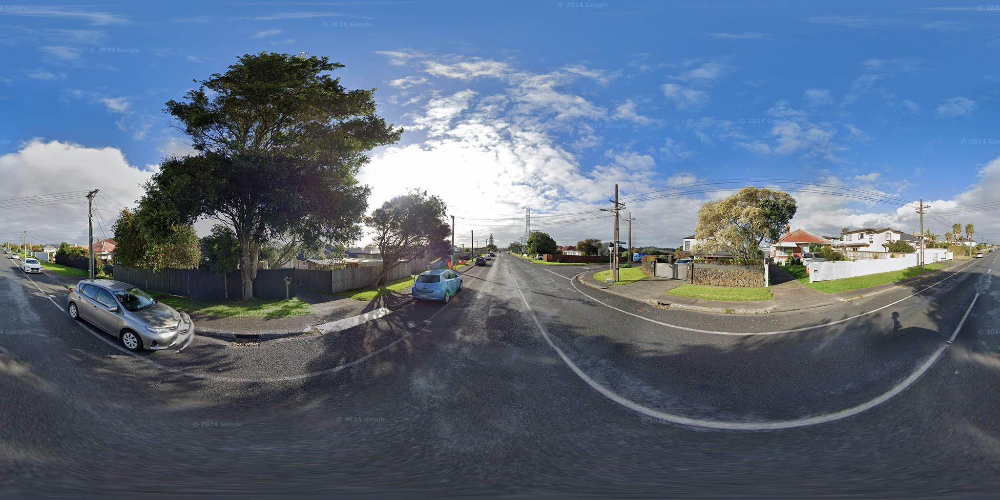

Output:
{'bikes': 0,
 'cars': 3,
 'environment': 'residential',
 'green': 40,
 'obscured': 60,
 'people': 0,
 'water': 0}




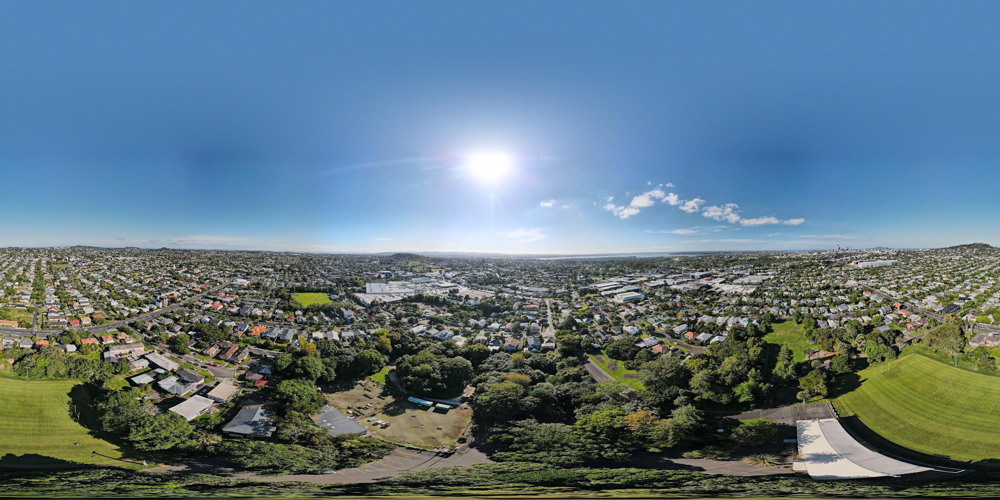

Output:
{'bikes': 0,
 'cars': 8,
 'environment': 'residential',
 'green': 25,
 'obscured': 40,
 'people': 0,
 'water': 0}




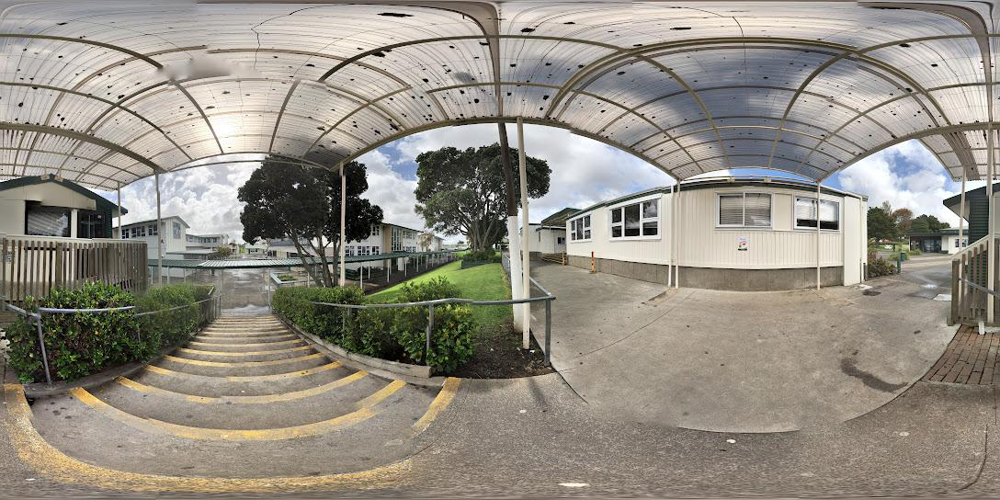

Output:
{'bikes': 0,
 'cars': 0,
 'environment': 'residential',
 'green': 40,
 'obscured': 70,
 'people': 0,
 'water': 0}




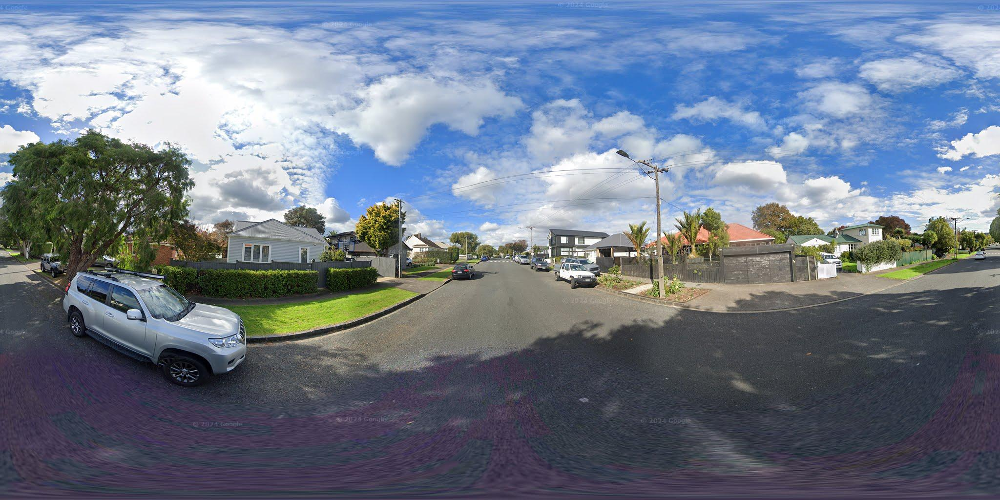

Output:
{'bikes': 0,
 'cars': 9,
 'environment': 'residential',
 'green': 50,
 'obscured': 40,
 'people': 0,
 'water': 0}




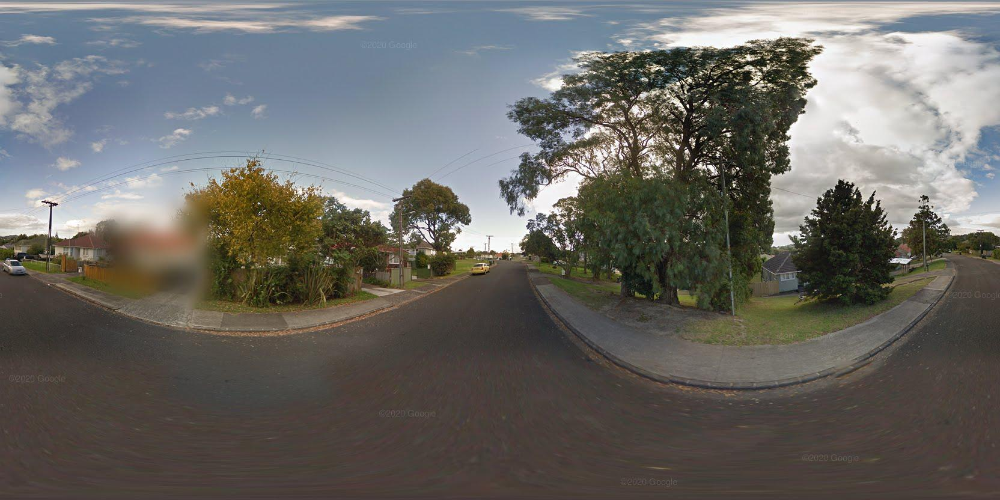

Output:
{'bikes': 0,
 'cars': 1,
 'environment': 'residential',
 'green': 10,
 'obscured': 50,
 'people': 0,
 'water': 0}




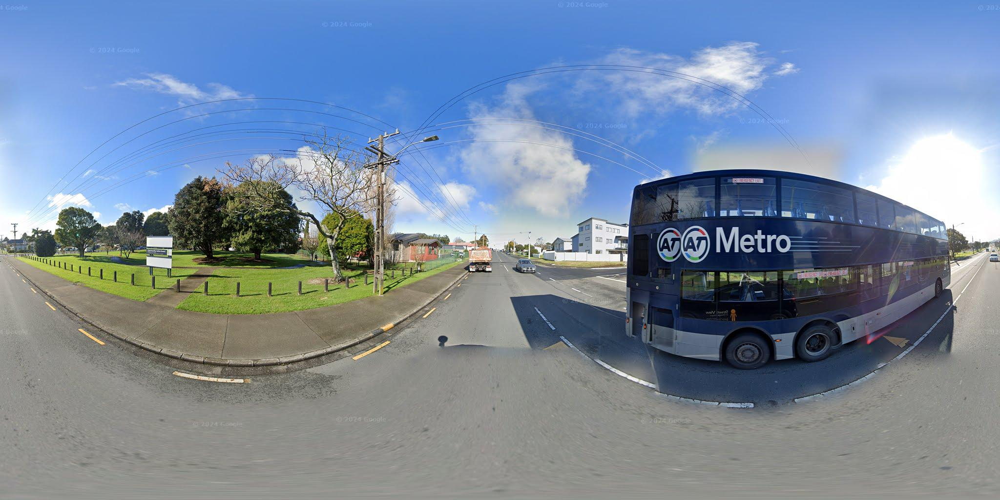

Output:
{'bikes': 0,
 'cars': 2,
 'environment': 'residential',
 'green': 30,
 'obscured': 40,
 'people': 1,
 'water': 0}




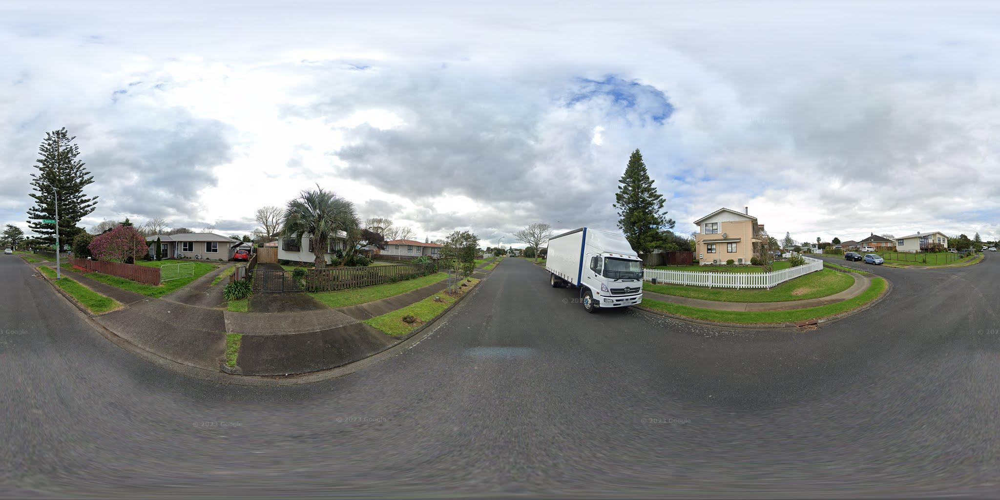

Output:
{'bikes': 0,
 'cars': 2,
 'environment': 'residential',
 'green': 30,
 'obscured': 20,
 'people': 0,
 'water': 0}




In [15]:
for row in tqdm(df.sample(10).itertuples(index=False)):
    panoid = row.panoid
    image = Image.open(f"panoramas/{panoid}.jpg")
    display(image)
    messages = [
        {
            "role": "user",
            "content": [
                {"type": "text", "text": """
                    This image is a panorama from Google Street View.
                    From the image, extract the following information, in JSON format:
                    green: Percentage of the image that is green space (e.g. parks, gardens, trees, grass etc.). A number from 0-100.
                    environment: Classify the nature of the environment in this image. Built up/green/residential/shops/cafes?. A string.
                    water: If you see any streams/ponds/rivers/ocean in the image, estimate the distance to the water in meters. A number. If there is no water, return 0.
                    obscured: Proportion of view obscured by buildings (how much of total line of sight is blocked by buildings in close proximity). A number from 0-100.
                    people: the number of people you see in the image
                    cars: the number of cars you see in the image
                    bikes: the number of bikes you see in the image

                    Do not include comments in your JSON response. Only respond with the JSON object. Make sure the JSON is valid.
                """},
                {"type": "image"},
            ]
        }
    ]
    input_text = processor.apply_chat_template(messages, add_generation_prompt=True)
    inputs = processor(
        image,
        input_text,
        add_special_tokens=False,
        return_tensors="pt"
    ).to(model.device)

    for retry in range(3):
        output = model.generate(**inputs, max_new_tokens=5000)
        result = processor.decode(output[0])
        result = result[result.rindex("<|end_header_id|>") + len("<|end_header_id|>"):].strip().replace("<|eot_id|>", "")
        print("Output:")
        try:
            result = json.loads(result)
            pprint(result)
            print("\n")
            break
        except json.JSONDecodeError:
            print(f"Unable to parse: {result}")

In [ ]:
results = []
for row in tqdm(df.itertuples(index=False), total=len(df)):
    panoid = row.panoid
    image = Image.open(f"panoramas/{panoid}.png")
    #display(image)
    messages = [
        {
            "role": "user",
            "content": [
                {"type": "text", "text": """
                    This image is a panorama from Google Street View.
                    From the image, extract the following information, in JSON format:
                    green: Percentage of the image that is green space (e.g. parks, gardens, trees, grass etc.). A number from 0-100.
                    environment: Classify the nature of the environment in this image. Built up/green/residential/shops/cafes?. A string.
                    water: If you see any streams/ponds/rivers/ocean in the image, estimate the distance to the water in meters. A number. If there is no water, return 0.
                    obscured: Proportion of view obscured by buildings (how much of total line of sight is blocked by buildings in close proximity). A number from 0-100.
                    people: the number of people you see in the image
                    cars: the number of cars you see in the image
                    bikes: the number of bikes you see in the image

                    Do not include comments in your JSON response. Only respond with the JSON object. Make sure the JSON is valid.
                """},
                {"type": "image"},
            ]
        }
    ]
    input_text = processor.apply_chat_template(messages, add_generation_prompt=True)
    inputs = processor(
        image,
        input_text,
        add_special_tokens=False,
        return_tensors="pt"
    ).to(model.device)

    for retry in range(3):
        output = model.generate(**inputs, max_new_tokens=5000)
        result = processor.decode(output[0])
        result = result[result.rindex("<|end_header_id|>") + len("<|end_header_id|>"):].strip().replace("<|eot_id|>", "")
        #print("Output:")
        try:
            result = json.loads(result)
            #pprint(result)
            row = row._asdict()
            row.update(result)
            results.append(row)
            print("\n")
            break
        except json.JSONDecodeError:
            print(f"Unable to parse: {result}")

results = pd.DataFrame(results)
results.to_csv("LLM_results.csv", index=False)
results